# Global Temperature Change

In this notebook, you will work with [temperature data compiled by the National Oceanic and Atmospheric Administration](https://www.ncei.noaa.gov/access/search/dataset-search?observationTypes=Land%20Surface&keywords=d559b900-eca6-42a4-9311-0297b2ef98ab) (NOAA) and [data from the National Aeronautics and Space Administration](https://climate.nasa.gov/climate_resources/139/video-global-warming-from-1880-to-2022/) (NASA) covering the years 1880 to 2021. 

Here are the steps you will complete in this notebook: 

1. Import Python packages.
2. Load and inspect the dataset.
3. Visualize global average temperature rise
4. Visualize local temperature behavior around the globe
5. Visualize global temperature anomalies
6. Visualize the impact of temperature rise

## 1. Import Python Packages

Run the next cell to import the Python packages you'll be using in this lab exercise. This is a common first step whenever working with Python. If everything goes well you should see a message when the cell has finished running that says "All packages imported successfully!".

Note the `import utils` line. This line imports the functions that were specifically written for this lab. If you want to look at what these functions are, go to `File -> Open...` and open the `utils.py` file to have a look.

In [1]:
# Import libraries
%matplotlib notebook

import utils
import pandas as pd
import numpy as np
import IPython
from itables import init_notebook_mode

init_notebook_mode(all_interactive=False)
print("All packages imported successfully!")

<IPython.core.display.Javascript object>

All packages imported successfully!


## 2. Load and Inspect the Dataset

NOAA offers lots of publicly available weather data you can work with. Here, you will read in a **C**omma **S**eparated **V**alues (CSV) file containing the average yearly temperature for multiple land-based weather stations around the world. Run the next cell to load this data into your notebook. 

In [2]:
temperature_data = pd.read_csv("data/global_temperature.csv")  # import the data
temperature_data.columns.values[4:] = temperature_data.columns[4:].map(
    int
)  # column names to int for easy manipulation
print("the dataset contains", len(temperature_data), "rows")
temperature_data.tail()

the dataset contains 794 rows


,STATION,NAME,LATITUDE,LONGITUDE,1880,1881,1882,1883,1884,1885,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
789,USW00094014,"WILLISTON SLOULIN FIELD, ND US",48.17380,-103.63660,NaN,NaN,NaN,NaN,NaN,NaN,...,6.7,4.3,4.9,7.0,7.6,6.4,4.8,NaN,NaN,NaN
790,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,11.6,11.2,10.9,10.1,11.2,10.3,...,14.1,13.0,12.4,13.7,14.0,13.5,13.3,13.1,14.1,13.8
791,USW00094849,"ALPENA CO REGIONAL AIRPORT, MI US",45.07160,-83.56451,NaN,NaN,NaN,NaN,NaN,NaN,...,8.4,6.0,4.9,6.9,8.1,7.6,6.9,6.0,7.7,8.3
792,USW00094967,"PARK RAPIDS MUNICIPAL AIRPORT, MN US",46.89967,-95.06682,NaN,NaN,NaN,NaN,NaN,NaN,...,6.3,3.0,2.8,6.3,6.8,5.3,4.0,3.1,4.8,6.1
793,UZM00038457,"TASHKENT, UZ",41.27000,69.26940,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,16.2,NaN,NaN,NaN,15.9,NaN,NaN,NaN,NaN


## 3. Visualize Global Average Temperature Rise <a class="anchor" id="global"></a>

Many climate change reports calculate global average temperature rise relative to a baseline that is the global average temperature in the pre-industrial period from 1850-1900. In practice, the global temperature data available prior to 1900 is sparse and therefore the pre-industrial level is often calculated by taking the average from 1981 through 2010 and subtracting 0.69 degrees celsius and that's what you'll do in the next cell. You can [learn more about how this offset is calculated here](https://climate.metoffice.cloud/temperature.html). 

When you run the next cell, you'll create a bar plot where a <span style="color: blue">negative value (in blue)</span> indicates that the temperature in that year was below the baseline, while a <span style="color: red">positive value (in red)</span> indicates a warmer than baseline year. You can <strong>left-click on any bar to get the exact value of that year</strong>. If you want to <strong>delete any of the labels you added, you have to right-click</strong> on the top of the label. 

<IPython.core.display.Javascript object>


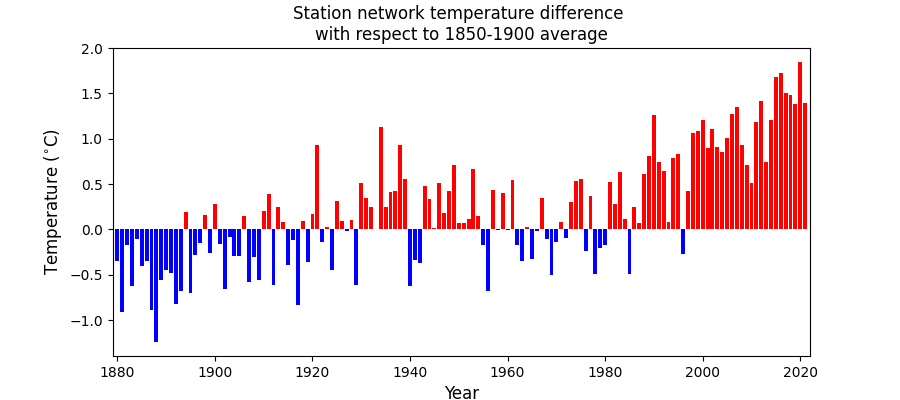

In [3]:
# Selection of the columns with the time series
plot_data = temperature_data[np.array(range(1880, 2022, 1))]
# Get difference with baseline
diff = plot_data.sub(plot_data.iloc[:, 101:132].dropna().mean(axis=1) - 0.69, axis=0)

# Create the bar chart
utils.bar_global(diff)

## 4. Visualize Local Temperature Behavior Around the Globe<a class="anchor" id="local"></a>

Temperature changes differently at different locations. For some places, the temperature is rising; for others, the change is not apparent or negligible, while for some points temperature appears to be decreasing over time. 

Run the next cell to plot a map with the weather station locations in the dataset. For each one of those points, <strong>you can click and explore</strong> a bar plot like the one you studied in the previous section. In this case, the baseline you're comparing against is simply the average temperature over the full range of the data at that location. Explore the map and see if you can find places where the temperature trend differs from what is happening globally. 

In [4]:
utils.local_temp_map(temperature_data)

## 5. Visualize Global Temperature Anomalies <a class="anchor" id="century"></a>

When you run the next cell, you'll generate a visual of the maps that were shown at the end of the last video. These [maps were constructed by NASA](https://climate.nasa.gov/climate_resources/139/video-global-warming-from-1880-to-2022/) to show temperature differences around the globe over the years 1884 to 2020. You can [learn more about the analysis used to create these maps here](https://climate.nasa.gov/vital-signs/global-temperature/).

<strong>To change the year of the map in the visualization, move the slider until the year you want to visualize</strong>. 

In [5]:
utils.slider_global_temp()

## 6. Visualize the Impact of Temperature Rise <a class="anchor" id="consequences"></a>

To wrap up this lab, you will see [satellite imagery from NASA](https://climate.nasa.gov/images-of-change?id=796#796-collapsing-ice-shelf-reveals-a-possible-new-island-eastern-antarctica) demonstrating how glaciers are receding due to global warming. You can interact with each visualization by moving the slider from right to left to look at the images from a previous point in time and from right to left to see them in recent times.  

### Melting Ice Shelf in Antarctica <a class="anchor" id="antarctica"></a>

Run the following cell, to visualize the state of the <a href="https://www.google.com/maps/place/Glenzer+Glacier/@-65.4494081,102.4040761,149178m/data=!3m1!1e3!4m5!3m4!1s0xaddefc6d31f95cdb:0x2278b8149d1a30d5!8m2!3d-65.966667!4d103.2499999!5m1!1e4" >Glenzer and Conger ice shelves in Antartica</a>, using satellite imagery from November 1989, and January 2022. 

In [6]:
# https://climate.nasa.gov/images-of-change/?id=796#796-collapsing-ice-shelf-reveals-a-possible-new-island-eastern-antarctica
src = "https://cdn.knightlab.com/libs/juxtapose/latest/embed/index.html?uid=dab72496-6d1f-11ed-b5bd-6595d9b17862"
IPython.display.IFrame(src, width=700, height=720)

### Melting Glaciers in Tibet <a class="anchor" id="tibet"></a>

Here, you can compare satellite imagery from October 1987 and October 2021 in the <a href="https://www.google.com/maps/place/Dorsoidong+Co/@33.4729454,89.7281098,81649m/data=!3m1!1e3!4m5!3m4!1s0x39d5edea3893bf41:0xc4f257040a288b56!8m2!3d33.3666667!4d89.8333333!5m1!1e4">Tibetan Plateau</a>. Rising temperatures have melted some of the glaciers in that region, enlarging some of the lakes there. 

In [7]:
# https://climate.nasa.gov/images-of-change/?id=778#778-melting-glaciers-enlarge-lakes-on-tibetan-plateau
src = "https://cdn.knightlab.com/libs/juxtapose/latest/embed/index.html?uid=269f7416-6d21-11ed-b5bd-6595d9b17862"
IPython.display.IFrame(src, width=750, height=520)

### Glacier Retreat in Alaska <a class="anchor" id="alaska"></a>

Next, you will compare satellite images from September 1984 and September 2019 showing the <a href= "https://www.google.com/maps/place/Grand+Plateau+Glacier/@59.0949234,-138.0848397,35549m/data=!3m1!1e3!4m5!3m4!1s0x56aa2da5a844e665:0xc5932e54ca2c6a43!8m2!3d59.0430556!4d-137.8844444!5m1!1e4">Grand Plateau glacier in the Glacier Bay National Park in southeast Alaska</a>. In that comparison, you will see how two glaciers' arms have retreated over the years. 

In [8]:
# https://climate.nasa.gov/images-of-change?id=777#777-grand-plateau-glacier-retreats
src = "https://cdn.knightlab.com/libs/juxtapose/latest/embed/index.html?uid=0c37b40e-7027-11ed-b5bd-6595d9b17862"
IPython.display.IFrame(src, width=700, height=550)